# Face Generation with DCGAN
In this project, I use deep convolutaional generative adversarial networks (DCGAN) to generate new images of human faces.

### Get the Data
There are two public datasets we could use in this project:
- MNIST
- CelebA

Since the celebA dataset is complex, we could optionally test the neural network on MNIST (handwritten digits) before CelebA.

In [1]:
import math
import os
import hashlib
from urllib.request import urlretrieve
import zipfile
import gzip
import shutil

import numpy as np
from PIL import Image
from tqdm import tqdm

In [2]:
def _read32(bytestream):
    """
    Read 32-bit integer from bytesteam
    :param bytestream: A bytestream
    :return: 32-bit integer
    """
    dt = np.dtype(np.uint32).newbyteorder('>')
    return np.frombuffer(bytestream.read(4), dtype=dt)[0]


def _unzip(save_path, _, database_name, data_path):
    """
    Unzip wrapper with the same interface as _ungzip
    :param save_path: The path of the gzip files
    :param database_name: Name of database
    :param data_path: Path to extract to
    :param _: HACK - Used to have to same interface as _ungzip
    """
    print('Extracting {}...'.format(database_name))
    with zipfile.ZipFile(save_path) as zf:
        zf.extractall(data_path)


def _ungzip(save_path, extract_path, database_name, _):
    """
    Unzip a gzip file and extract it to extract_path
    :param save_path: The path of the gzip files
    :param extract_path: The location to extract the data to
    :param database_name: Name of database
    :param _: HACK - Used to have to same interface as _unzip
    """
    # Get data from save_path
    with open(save_path, 'rb') as f:
        with gzip.GzipFile(fileobj=f) as bytestream:
            magic = _read32(bytestream)
            if magic != 2051:
                raise ValueError('Invalid magic number {} in file: {}'.format(magic, f.name))
            num_images = _read32(bytestream)
            rows = _read32(bytestream)
            cols = _read32(bytestream)
            buf = bytestream.read(rows * cols * num_images)
            data = np.frombuffer(buf, dtype=np.uint8)
            data = data.reshape(num_images, rows, cols)

    # Save data to extract_path
    for image_i, image in enumerate(
            tqdm(data, unit='File', unit_scale=True, miniters=1, desc='Extracting {}'.format(database_name))):
        Image.fromarray(image, 'L').save(os.path.join(extract_path, 'image_{}.jpg'.format(image_i)))


def get_image(image_path, width, height, mode):
    """
    Read image from image_path
    :param image_path: Path of image
    :param width: Width of image
    :param height: Height of image
    :param mode: Mode of image
    :return: Image data
    """
    image = Image.open(image_path)

    if image.size != (width, height):  # HACK - Check if image is from the CELEBA dataset
        # Remove most pixels that aren't part of a face
        face_width = face_height = 108
        j = (image.size[0] - face_width) // 2
        i = (image.size[1] - face_height) // 2
        image = image.crop([j, i, j + face_width, i + face_height])
        image = image.resize([width, height], Image.BILINEAR)

    return np.array(image.convert(mode))


def get_batch(image_files, width, height, mode):
    data_batch = np.array(
        [get_image(sample_file, width, height, mode) for sample_file in image_files]).astype(np.float32)

    # Make sure the images are in 4 dimensions
    if len(data_batch.shape) < 4:
        data_batch = data_batch.reshape(data_batch.shape + (1,))

    return data_batch


def images_square_grid(images, mode):
    """
    Save images as a square grid
    :param images: Images to be used for the grid
    :param mode: The mode to use for images
    :return: Image of images in a square grid
    """
    # Get maximum size for square grid of images
    save_size = math.floor(np.sqrt(images.shape[0]))

    # Scale to 0-255
    images = (((images - images.min()) * 255) / (images.max() - images.min())).astype(np.uint8)

    # Put images in a square arrangement
    images_in_square = np.reshape(
            images[:save_size*save_size],
            (save_size, save_size, images.shape[1], images.shape[2], images.shape[3]))
    if mode == 'L':
        images_in_square = np.squeeze(images_in_square, 4)

    # Combine images to grid image
    new_im = Image.new(mode, (images.shape[1] * save_size, images.shape[2] * save_size))
    for col_i, col_images in enumerate(images_in_square):
        for image_i, image in enumerate(col_images):
            im = Image.fromarray(image, mode)
            new_im.paste(im, (col_i * images.shape[1], image_i * images.shape[2]))

    return new_im


def download_extract(database_name, data_path):
    """
    Download and extract database
    :param database_name: Database name
    """
    DATASET_CELEBA_NAME = 'celeba'
    DATASET_MNIST_NAME = 'mnist'

    if database_name == DATASET_CELEBA_NAME:
        url = 'https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip'
        hash_code = '00d2c5bc6d35e252742224ab0c1e8fcb'
        extract_path = os.path.join(data_path, 'img_align_celeba')
        save_path = os.path.join(data_path, 'celeba.zip')
        extract_fn = _unzip
    elif database_name == DATASET_MNIST_NAME:
        url = 'http://yann.lecun.com/exdb/mnist/train-images-idx3-ubyte.gz'
        hash_code = 'f68b3c2dcbeaaa9fbdd348bbdeb94873'
        extract_path = os.path.join(data_path, 'mnist')
        save_path = os.path.join(data_path, 'train-images-idx3-ubyte.gz')
        extract_fn = _ungzip

    if os.path.exists(extract_path):
        print('Found {} Data'.format(database_name))
        return

    if not os.path.exists(data_path):
        os.makedirs(data_path)

    if not os.path.exists(save_path):
        with DLProgress(unit='B', unit_scale=True, miniters=1, desc='Downloading {}'.format(database_name)) as pbar:
            urlretrieve(
                url,
                save_path,
                pbar.hook)

    assert hashlib.md5(open(save_path, 'rb').read()).hexdigest() == hash_code, \
        '{} file is corrupted.  Remove the file and try again.'.format(save_path)

    os.makedirs(extract_path)
    try:
        extract_fn(save_path, extract_path, database_name, data_path)
    except Exception as err:
        shutil.rmtree(extract_path)  # Remove extraction folder if there is an error
        raise err

    # Remove compressed data
    os.remove(save_path)


class Dataset(object):
    """
    Dataset
    """
    def __init__(self, dataset_name, data_files):
        """
        Initalize the class
        :param dataset_name: Database name
        :param data_files: List of files in the database
        """
        DATASET_CELEBA_NAME = 'celeba'
        DATASET_MNIST_NAME = 'mnist'
        IMAGE_WIDTH = 28
        IMAGE_HEIGHT = 28

        if dataset_name == DATASET_CELEBA_NAME:
            self.image_mode = 'RGB'
            image_channels = 3

        elif dataset_name == DATASET_MNIST_NAME:
            self.image_mode = 'L'
            image_channels = 1

        self.data_files = data_files
        self.shape = len(data_files), IMAGE_WIDTH, IMAGE_HEIGHT, image_channels

    def get_batches(self, batch_size):
        """
        Generate batches
        :param batch_size: Batch Size
        :return: Batches of data
        """
        IMAGE_MAX_VALUE = 255

        current_index = 0
        while current_index + batch_size <= self.shape[0]:
            data_batch = get_batch(
                self.data_files[current_index:current_index + batch_size],
                *self.shape[1:3],
                self.image_mode)

            current_index += batch_size

            yield data_batch / IMAGE_MAX_VALUE - 0.5


class DLProgress(tqdm):
    """
    Handle Progress Bar while Downloading
    """
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        """
        A hook function that will be called once on establishment of the network connection and
        once after each block read thereafter.
        :param block_num: A count of blocks transferred so far
        :param block_size: Block size in bytes
        :param total_size: The total size of the file. This may be -1 on older FTP servers which do not return
                            a file size in response to a retrieval request.
        """
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

In [3]:
data_dir = '/data'
download_extract('mnist', data_dir)
download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Exploring the Data


### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since we're going to be generating faces, we won't need the annotations. Next, there are some examples of human faces in the CelebA dataset.

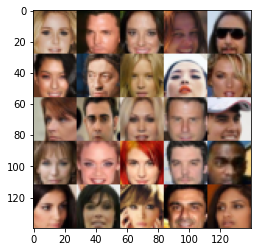

In [6]:
show_n_images = 25

%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(images_square_grid(mnist_images, 'RGB'))

## Preprocessing the Data
Since the project's main focus is on building the generative adversarial networks (GANs), we'll need to preprocess the data. The dataste we'll be working on is the CelebA dataset, alternatively, we could use a simpler dataset such as the MNIST dataset for handwritten digits. The values of the MNIST and CelebA dataset must be in the range of -0.5 to 0.5 of 28x28 dimensional images. The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single color channel while the CelebA images have 3 color channels (RGB color channel).

## Building the Neural Network
In order to build a GANs, we need to implement two main networks:
- `discriminator`
- `generator`

### Checking the version of TensorFlow and access to GPU
This will check to make sure we have the correct version of TensorFlow and access to a GPU. Training on a CPU might take a *very* long time.

In [7]:

from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 2.3.0
Default GPU Device: /device:GPU:0


### Input
The `model_inputs` function is used to create TF Placeholders for the Neural Network. It creates the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.
The function returns a tuple of (tensor output of the inputs, tensor of z, tensor for the learning rate).

In [8]:
def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    input_images = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name = 'input_images')
    z = tf.placeholder(tf.float32, [None, z_dim], name = 'z')
    learn_rate = tf.placeholder(tf.float32, [], name = 'learn_rate') # Personal note: If you don't explicitely write [] it throws an error.

    return input_images, z, learn_rate

### Discriminator
This function `discriminator` has the architechture to create a discriminator neural network that *discriminates* on `images`.  This function should be able to reuse the variables in the neural network.  Using [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" allows the variables to be reused. The function returns a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [9]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
        
    with tf.variable_scope('discriminator', reuse=reuse):
        
        # Zero conv layer (I know activation is None by default, but I use it as a reminder)
        x = tf.layers.conv2d(images, 64, kernel_size = 5, strides = 2, activation = None, padding = 'SAME')
        x = tf.maximum(0.1*x, x)

        # First conv layer
        x = tf.layers.conv2d(x, 128, kernel_size = 5, strides = 2, activation = None, padding = 'SAME')
        x = tf.layers.batch_normalization(x, training = True)
        x = tf.layers.dropout(x)
        x = tf.maximum(0.1*x, x)

        # Second conv layer
        x = tf.layers.conv2d(x, 512, kernel_size = 5, strides = 1, activation = None, padding = 'SAME')
        x = tf.layers.batch_normalization(x, training = True)
        x = tf.layers.dropout(x)
        x = tf.maximum(0.1*x, x)

        # Final dense layer
        x_flat = tf.reshape(x, (-1, 7*7*512))
        #x_flat = tf.contrib.layers.flatten(x)
        logits = tf.layers.dense(x_flat, 1)
        
        out = tf.sigmoid(logits)
        
    return out, logits

### Generator
The function `generator` has the architechture to generate an image using `z`. This function is able to reuse the variables in the neural network.  Using [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" allows the variables to be reused. The function returns the generated 28 x 28 x `out_channel_dim` images.

In [10]:
def generator(z, out_channel_dim, is_train=True, reuse = False):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
        
    if is_train:
        reuse = False
    else:
        reuse = True
    
    with tf.variable_scope('generator', reuse=reuse):
        
        # First layer, from z to a "deep" image
        x = tf.layers.dense(z, 7*7*512, activation = None)
        x = tf.reshape(x, (-1, 7, 7, 512))
        x = tf.layers.batch_normalization(x, training = is_train)
        x = tf.layers.dropout(x)
        x = tf.maximum(x*0.1, x)
        
        # Second layer
        x = tf.layers.conv2d_transpose(x, 128, kernel_size = 5, strides = 2, activation = None, padding = 'SAME')
        x = tf.layers.batch_normalization(x, training = is_train)
        x = tf.layers.dropout(x)
        x = tf. maximum(x*0.1, x)
        
        # Third layer
        x = tf.layers.conv2d_transpose(x, 64, kernel_size = 5, strides = 2, activation = None, padding = 'SAME')
        x = tf.layers.batch_normalization(x, training = is_train)
        x = tf.layers.dropout(x)
        x = tf.maximum(x*0.1, x)
        
        # Last layer (logits)
        logits = tf.layers.conv2d_transpose(x, out_channel_dim, kernel_size = 5, strides = 1, activation = None, padding = 'SAME')
        out = tf.tanh(logits)
    
    return out

### Loss
The function `model_loss` is used to build the GANs for training and calculate the loss. The function returns a tuple of (discriminator loss, generator loss). It uses the following functions(inputs):
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [11]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse = True) # A new network? Or should I reuse it? reuse = True!
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_fake, 
                                                                    labels = tf.ones_like(d_model_fake)))
    
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_fake, 
                                                                         labels = tf.zeros_like(d_model_fake)))
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = d_logits_real, 
                                                                         labels = tf.ones_like(d_model_real)*(1 - 0.1)))
    
    d_loss = tf.add(d_loss_fake, d_loss_real)
    
    
    return d_loss, g_loss

### Optimization
The function `model_opt` is used to create the optimization operations for the GANs. Using [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) gets all the trainable variables.  It filters the variables with names that are in the discriminator and generator scope names.  The function returns a tuple of (discriminator training operation, generator training operation).

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    # What do I need to train (to eventually minimize the loss)? - Rhetoric question =)
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    # How should I train it then? Minimize the loss using Adam
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        #d_train_opt = tf.train.GradientDescentOptimizer(learning_rate*10).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
    return d_train_opt, g_train_opt

## Neural Network Training
### Show Output
This function shows the current output of the generator during training. It helps to determine how well the GANs is training.

In [13]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
The function `train` is needed to build and train the GANs. It uses the following functions(inputs):
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

By using the `show_generator_output` to show `generator` output while training. Running `show_generator_output` for every batch drastically increases the training time and increases the size of the notebook.  It's recommended to print the `generator` output every 100 batches or more.

In [14]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    #saver = tf.train.Saver()
    
    losses = []
    samples =  data_shape[0]//batch_size
    steps = 0
    
    image_width = data_shape[1]
    image_height = data_shape[2]
    image_channels = data_shape[3]
    
    input_real, input_z, learn_rate = model_inputs(image_width, image_height, image_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learn_rate, beta1)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                
                # Counting loops
                steps = steps + 1
                
                # Create a random z input with the corresponding batch_size and z_dim
                batch_zz =np.random.uniform(-1, 1, size=(batch_size, z_dim)).astype('f')
                
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_zz, learn_rate: learning_rate})
                _ = sess.run(g_train_opt, feed_dict={input_z: batch_zz, learn_rate: learning_rate, input_real: batch_images})
        
                if steps % 200 == 0:
                    # What was the loss for d and g at this point? Let's print it out
                    train_loss_d = sess.run(d_loss, {input_z: batch_zz, input_real: batch_images, learn_rate: learning_rate,
                                                    input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_zz, learn_rate: learning_rate, input_real: batch_images})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    
                    # Save losses to view after training (because for the CelebA takes too long to not save it!)
                    losses.append((train_loss_d, train_loss_g))
        
                # 100 is the minimum recommended
                if steps % 400 == 0:
                    show_generator_output(sess, 25, input_z, image_channels, data_image_mode)
                
                if steps == (epoch_i+1)*(samples-1):
                    show_generator_output(sess, 25, input_z, image_channels, data_image_mode)
        #saver.save(sess, './checkpoints/face_gen_JR.ckpt')
        

### Tensorflow higher or equal to 2.0
Due to compatibility reasons, we need to disable the behavior of tensorflow 2.x that might affect a code written originally for tensorflow 1.x as this one.

In [15]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior() 

Instructions for updating:
non-resource variables are not supported in the long term


### CelebA
Let's test now the GANs on CelebA.  It takes around 20 minutes on the average GPU to run one epoch.

Epoch 1/10... Discriminator Loss: 0.8766... Generator Loss: 11.4125
Epoch 1/10... Discriminator Loss: 0.4125... Generator Loss: 12.1556


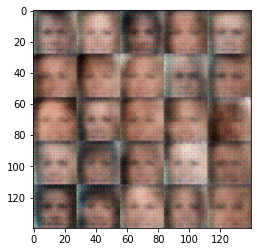

Epoch 1/10... Discriminator Loss: 0.3481... Generator Loss: 12.8837
Epoch 1/10... Discriminator Loss: 0.5827... Generator Loss: 2.0602


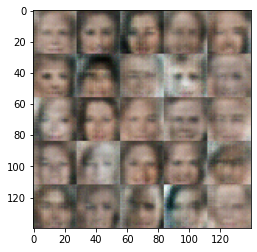

Epoch 1/10... Discriminator Loss: 0.4151... Generator Loss: 3.3531
Epoch 1/10... Discriminator Loss: 0.9085... Generator Loss: 1.0810


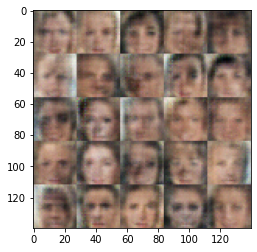

Epoch 1/10... Discriminator Loss: 0.4465... Generator Loss: 3.6237
Epoch 1/10... Discriminator Loss: 0.4224... Generator Loss: 3.4020


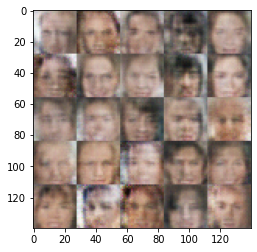

Epoch 1/10... Discriminator Loss: 0.4143... Generator Loss: 7.9522
Epoch 1/10... Discriminator Loss: 0.5313... Generator Loss: 2.7216


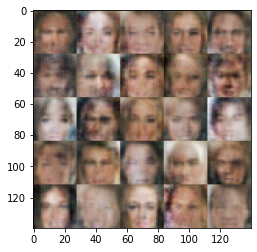

Epoch 1/10... Discriminator Loss: 1.8067... Generator Loss: 6.1036
Epoch 1/10... Discriminator Loss: 1.2088... Generator Loss: 1.0853


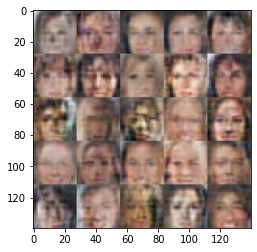

Epoch 1/10... Discriminator Loss: 1.0651... Generator Loss: 5.8550
Epoch 1/10... Discriminator Loss: 0.4694... Generator Loss: 4.4846


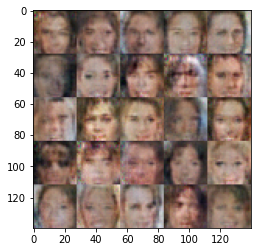

Epoch 1/10... Discriminator Loss: 0.3999... Generator Loss: 3.8062
Epoch 1/10... Discriminator Loss: 0.4064... Generator Loss: 6.6069


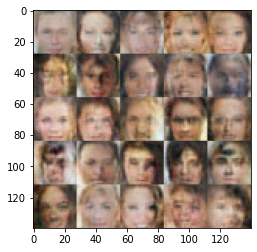

Epoch 1/10... Discriminator Loss: 1.1829... Generator Loss: 0.9950
Epoch 1/10... Discriminator Loss: 0.6209... Generator Loss: 2.7212


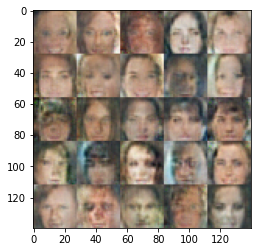

Epoch 1/10... Discriminator Loss: 0.9089... Generator Loss: 1.1752
Epoch 1/10... Discriminator Loss: 0.4002... Generator Loss: 3.3713


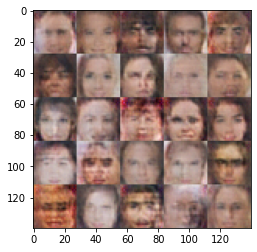

Epoch 1/10... Discriminator Loss: 0.5646... Generator Loss: 2.0686
Epoch 1/10... Discriminator Loss: 0.9850... Generator Loss: 1.1933


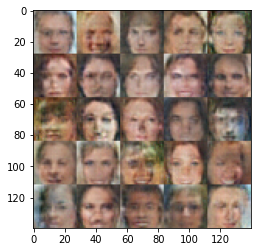

Epoch 1/10... Discriminator Loss: 0.5824... Generator Loss: 2.3917
Epoch 1/10... Discriminator Loss: 0.5492... Generator Loss: 2.4631


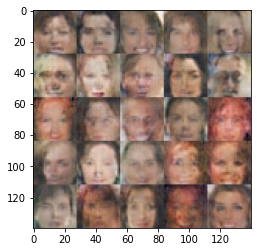

Epoch 1/10... Discriminator Loss: 0.4112... Generator Loss: 3.2900
Epoch 1/10... Discriminator Loss: 0.5734... Generator Loss: 2.1059


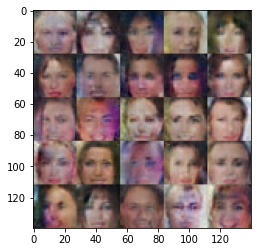

Epoch 1/10... Discriminator Loss: 0.9321... Generator Loss: 1.1059
Epoch 1/10... Discriminator Loss: 0.4728... Generator Loss: 4.2462


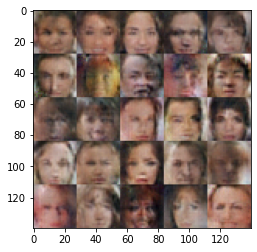

Epoch 1/10... Discriminator Loss: 0.5923... Generator Loss: 2.2709
Epoch 1/10... Discriminator Loss: 0.9760... Generator Loss: 1.0463


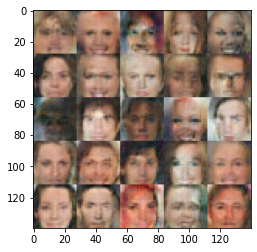

Epoch 1/10... Discriminator Loss: 1.0503... Generator Loss: 0.8500


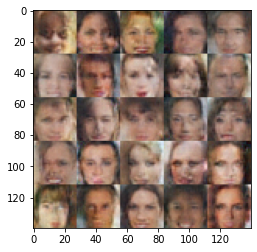

Epoch 2/10... Discriminator Loss: 1.3075... Generator Loss: 0.7213


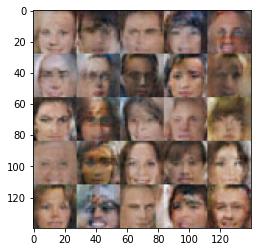

Epoch 2/10... Discriminator Loss: 2.3455... Generator Loss: 0.2526
Epoch 2/10... Discriminator Loss: 0.4019... Generator Loss: 4.0040


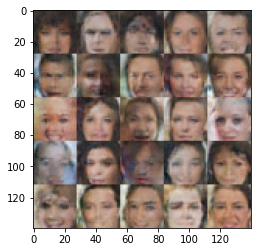

Epoch 2/10... Discriminator Loss: 0.5715... Generator Loss: 2.2075
Epoch 2/10... Discriminator Loss: 2.5032... Generator Loss: 5.2034


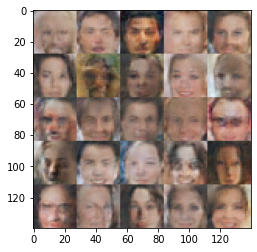

Epoch 2/10... Discriminator Loss: 1.2454... Generator Loss: 0.6546
Epoch 2/10... Discriminator Loss: 0.8000... Generator Loss: 1.2582


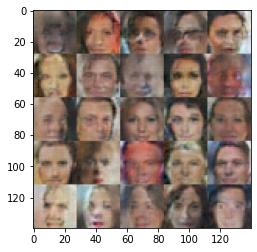

Epoch 2/10... Discriminator Loss: 1.0478... Generator Loss: 1.2281
Epoch 2/10... Discriminator Loss: 0.9952... Generator Loss: 0.9092


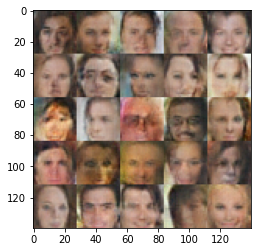

Epoch 2/10... Discriminator Loss: 1.0141... Generator Loss: 2.8566
Epoch 2/10... Discriminator Loss: 1.2476... Generator Loss: 0.5985


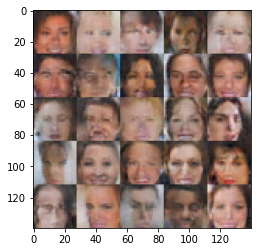

Epoch 2/10... Discriminator Loss: 0.4417... Generator Loss: 3.7673
Epoch 2/10... Discriminator Loss: 0.7761... Generator Loss: 1.3410


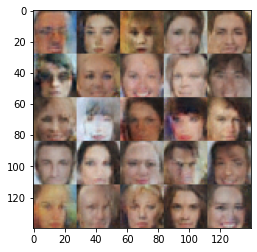

Epoch 2/10... Discriminator Loss: 0.8981... Generator Loss: 1.5013
Epoch 2/10... Discriminator Loss: 0.6424... Generator Loss: 2.3611


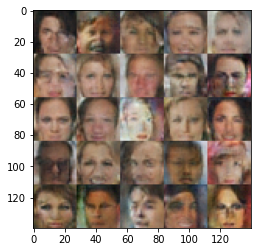

Epoch 2/10... Discriminator Loss: 1.2589... Generator Loss: 0.6854
Epoch 2/10... Discriminator Loss: 0.8084... Generator Loss: 1.6809


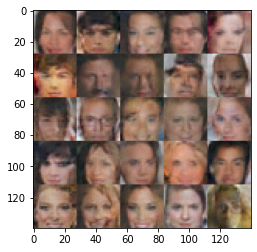

Epoch 2/10... Discriminator Loss: 1.0345... Generator Loss: 0.9566
Epoch 2/10... Discriminator Loss: 1.2427... Generator Loss: 0.6608


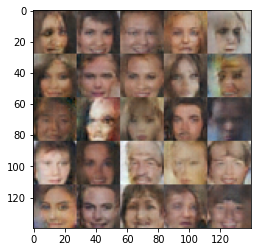

Epoch 2/10... Discriminator Loss: 0.6730... Generator Loss: 1.7175
Epoch 2/10... Discriminator Loss: 2.4296... Generator Loss: 0.2052


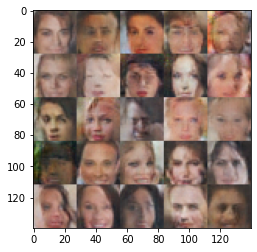

Epoch 2/10... Discriminator Loss: 1.3567... Generator Loss: 0.6044
Epoch 2/10... Discriminator Loss: 0.7652... Generator Loss: 1.5249


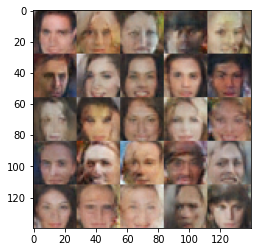

Epoch 2/10... Discriminator Loss: 1.0044... Generator Loss: 2.1487
Epoch 2/10... Discriminator Loss: 1.4056... Generator Loss: 0.5573


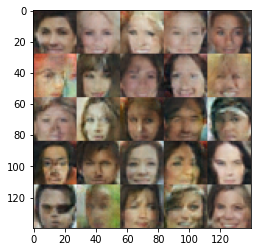

Epoch 2/10... Discriminator Loss: 1.4518... Generator Loss: 0.5361
Epoch 2/10... Discriminator Loss: 0.9362... Generator Loss: 3.8259


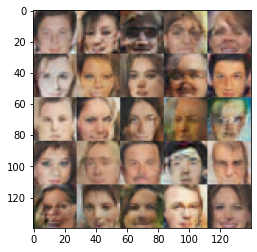

Epoch 2/10... Discriminator Loss: 1.2310... Generator Loss: 0.6283
Epoch 2/10... Discriminator Loss: 0.8916... Generator Loss: 1.2088


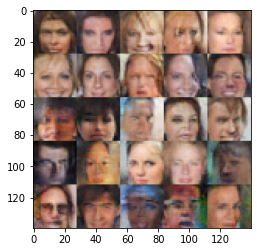

Epoch 2/10... Discriminator Loss: 1.6074... Generator Loss: 0.4075
Epoch 2/10... Discriminator Loss: 1.5972... Generator Loss: 0.4050


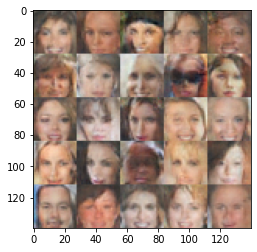

Epoch 2/10... Discriminator Loss: 1.4007... Generator Loss: 0.6089


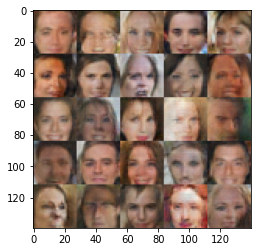

Epoch 3/10... Discriminator Loss: 0.7243... Generator Loss: 1.4890


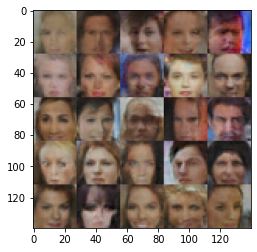

Epoch 3/10... Discriminator Loss: 1.0616... Generator Loss: 0.8293
Epoch 3/10... Discriminator Loss: 1.3340... Generator Loss: 0.5622


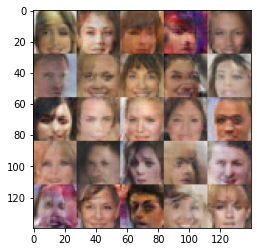

Epoch 3/10... Discriminator Loss: 1.8244... Generator Loss: 0.3519
Epoch 3/10... Discriminator Loss: 1.8704... Generator Loss: 0.3052


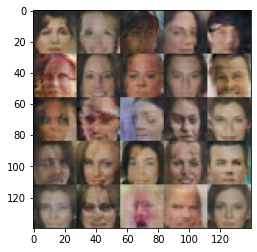

Epoch 3/10... Discriminator Loss: 1.6253... Generator Loss: 0.5703
Epoch 3/10... Discriminator Loss: 1.1884... Generator Loss: 0.6420


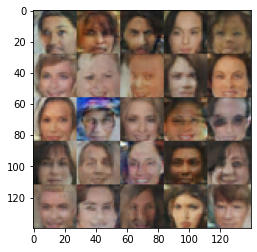

Epoch 3/10... Discriminator Loss: 1.2173... Generator Loss: 0.7854
Epoch 3/10... Discriminator Loss: 2.0080... Generator Loss: 0.2732


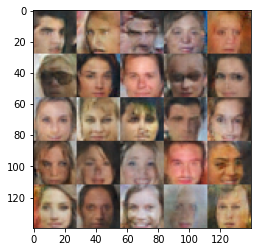

Epoch 3/10... Discriminator Loss: 2.0032... Generator Loss: 0.2665
Epoch 3/10... Discriminator Loss: 1.4439... Generator Loss: 0.5797


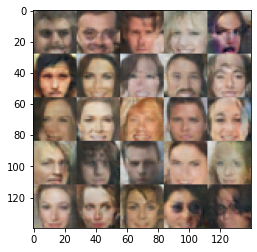

Epoch 3/10... Discriminator Loss: 1.3109... Generator Loss: 0.6841
Epoch 3/10... Discriminator Loss: 1.4710... Generator Loss: 0.4611


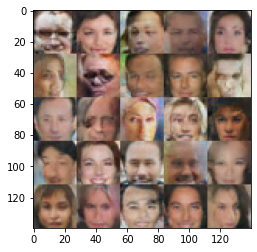

Epoch 3/10... Discriminator Loss: 1.6259... Generator Loss: 0.4074
Epoch 3/10... Discriminator Loss: 1.4118... Generator Loss: 0.5179


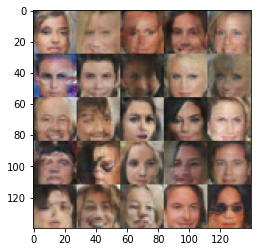

Epoch 3/10... Discriminator Loss: 1.8855... Generator Loss: 0.3161
Epoch 3/10... Discriminator Loss: 1.4218... Generator Loss: 0.6460


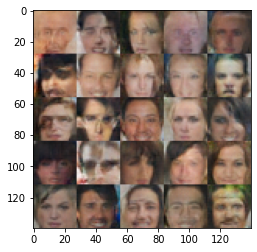

Epoch 3/10... Discriminator Loss: 1.5751... Generator Loss: 0.4167
Epoch 3/10... Discriminator Loss: 1.3512... Generator Loss: 0.6092


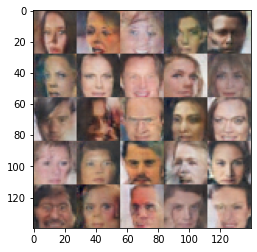

Epoch 3/10... Discriminator Loss: 1.5591... Generator Loss: 0.4674
Epoch 3/10... Discriminator Loss: 1.3418... Generator Loss: 0.5710


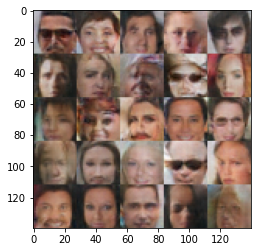

Epoch 3/10... Discriminator Loss: 0.9787... Generator Loss: 1.0400
Epoch 3/10... Discriminator Loss: 0.9371... Generator Loss: 1.0153


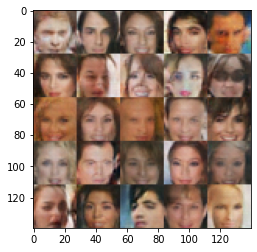

Epoch 3/10... Discriminator Loss: 1.4610... Generator Loss: 0.4974
Epoch 3/10... Discriminator Loss: 0.9693... Generator Loss: 1.3348


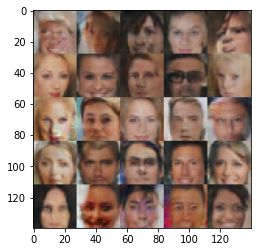

Epoch 3/10... Discriminator Loss: 1.7469... Generator Loss: 0.4321
Epoch 3/10... Discriminator Loss: 2.2332... Generator Loss: 0.1927


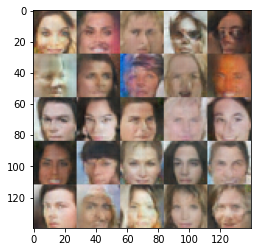

Epoch 3/10... Discriminator Loss: 1.8641... Generator Loss: 0.3073
Epoch 3/10... Discriminator Loss: 0.8839... Generator Loss: 1.2356


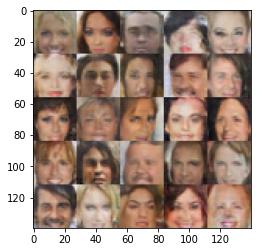

Epoch 3/10... Discriminator Loss: 1.2607... Generator Loss: 0.5890
Epoch 3/10... Discriminator Loss: 0.8557... Generator Loss: 1.5100


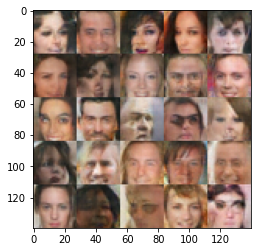

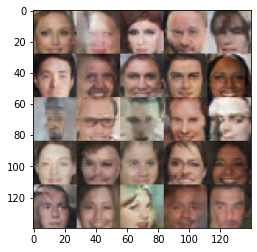

Epoch 4/10... Discriminator Loss: 1.1392... Generator Loss: 0.7409
Epoch 4/10... Discriminator Loss: 1.7882... Generator Loss: 0.3275


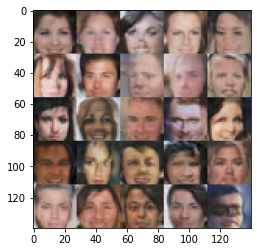

Epoch 4/10... Discriminator Loss: 1.3808... Generator Loss: 0.5755
Epoch 4/10... Discriminator Loss: 1.1353... Generator Loss: 1.1574


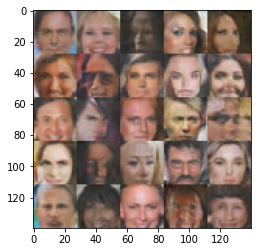

Epoch 4/10... Discriminator Loss: 1.6946... Generator Loss: 0.3838
Epoch 4/10... Discriminator Loss: 1.8130... Generator Loss: 0.3110


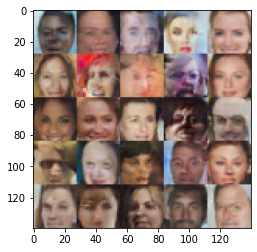

Epoch 4/10... Discriminator Loss: 1.6257... Generator Loss: 0.4032
Epoch 4/10... Discriminator Loss: 2.4408... Generator Loss: 0.1663


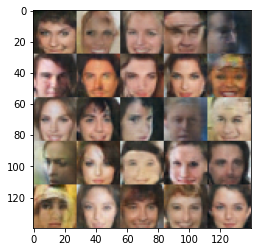

Epoch 4/10... Discriminator Loss: 1.1812... Generator Loss: 0.7494
Epoch 4/10... Discriminator Loss: 1.7898... Generator Loss: 0.3276


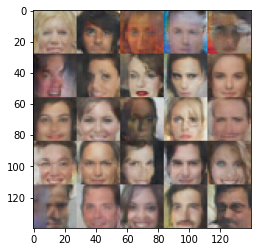

Epoch 4/10... Discriminator Loss: 1.1582... Generator Loss: 0.7602
Epoch 4/10... Discriminator Loss: 1.5762... Generator Loss: 0.4260


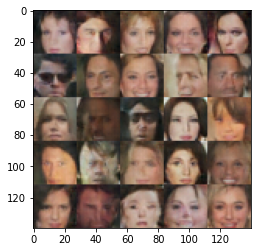

Epoch 4/10... Discriminator Loss: 1.4187... Generator Loss: 0.4822
Epoch 4/10... Discriminator Loss: 1.4594... Generator Loss: 0.9267


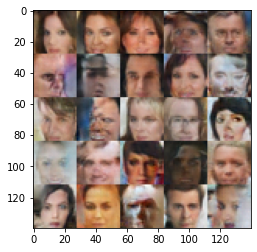

Epoch 4/10... Discriminator Loss: 1.3494... Generator Loss: 0.5976
Epoch 4/10... Discriminator Loss: 1.2124... Generator Loss: 0.7313


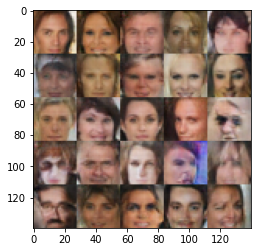

Epoch 4/10... Discriminator Loss: 1.3079... Generator Loss: 0.6507
Epoch 4/10... Discriminator Loss: 0.9894... Generator Loss: 1.0172


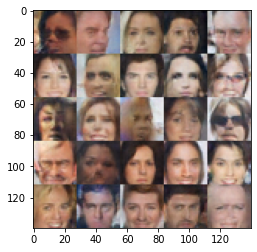

Epoch 4/10... Discriminator Loss: 1.2461... Generator Loss: 1.2358
Epoch 4/10... Discriminator Loss: 1.4714... Generator Loss: 0.5407


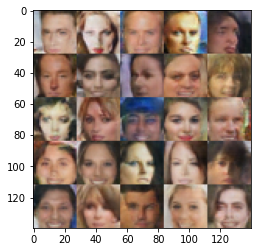

Epoch 4/10... Discriminator Loss: 1.5371... Generator Loss: 0.4414
Epoch 4/10... Discriminator Loss: 0.9923... Generator Loss: 0.9963


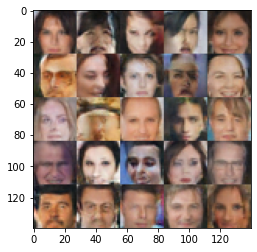

Epoch 4/10... Discriminator Loss: 0.9355... Generator Loss: 1.3362
Epoch 4/10... Discriminator Loss: 1.3636... Generator Loss: 0.6230


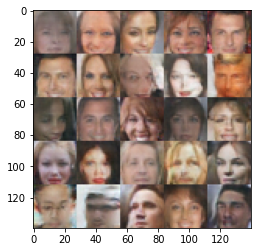

Epoch 4/10... Discriminator Loss: 1.2429... Generator Loss: 0.6818
Epoch 4/10... Discriminator Loss: 1.2415... Generator Loss: 0.7179


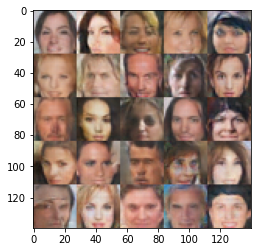

Epoch 4/10... Discriminator Loss: 1.2508... Generator Loss: 0.8884
Epoch 4/10... Discriminator Loss: 1.5071... Generator Loss: 0.5814


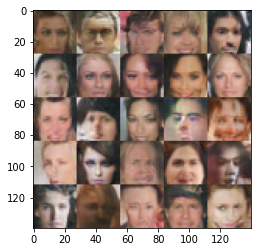

Epoch 4/10... Discriminator Loss: 1.8339... Generator Loss: 0.3016
Epoch 4/10... Discriminator Loss: 0.8566... Generator Loss: 1.1609


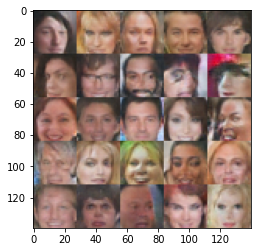

Epoch 4/10... Discriminator Loss: 1.2728... Generator Loss: 0.5961
Epoch 4/10... Discriminator Loss: 1.0976... Generator Loss: 0.7897


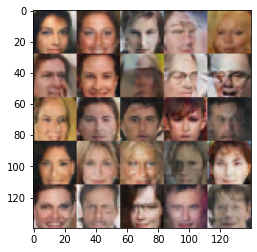

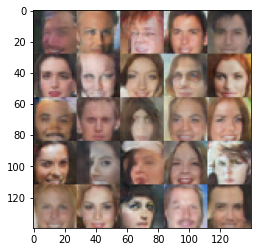

Epoch 5/10... Discriminator Loss: 1.4085... Generator Loss: 0.5641
Epoch 5/10... Discriminator Loss: 1.4436... Generator Loss: 0.4835


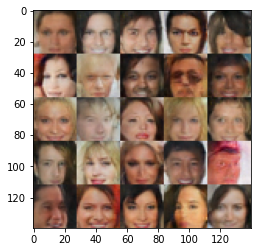

Epoch 5/10... Discriminator Loss: 1.6824... Generator Loss: 0.3827
Epoch 5/10... Discriminator Loss: 0.9686... Generator Loss: 1.6956


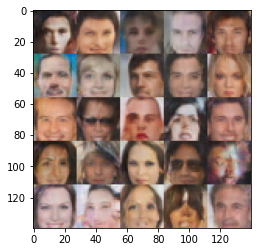

Epoch 5/10... Discriminator Loss: 1.1107... Generator Loss: 0.7575
Epoch 5/10... Discriminator Loss: 0.8250... Generator Loss: 1.1895


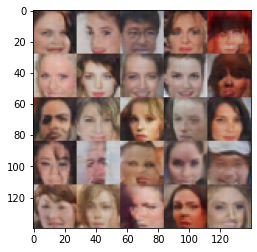

Epoch 5/10... Discriminator Loss: 1.8640... Generator Loss: 0.3514
Epoch 5/10... Discriminator Loss: 1.2421... Generator Loss: 0.6875


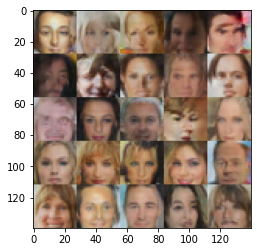

Epoch 5/10... Discriminator Loss: 1.3984... Generator Loss: 0.7068
Epoch 5/10... Discriminator Loss: 1.3644... Generator Loss: 0.5650


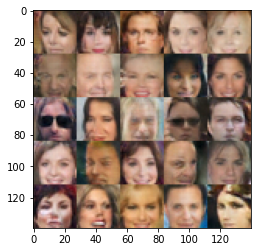

Epoch 5/10... Discriminator Loss: 0.8169... Generator Loss: 1.3948
Epoch 5/10... Discriminator Loss: 1.0972... Generator Loss: 0.8152


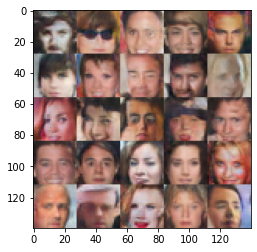

Epoch 5/10... Discriminator Loss: 1.2159... Generator Loss: 0.7249
Epoch 5/10... Discriminator Loss: 1.4074... Generator Loss: 0.5242


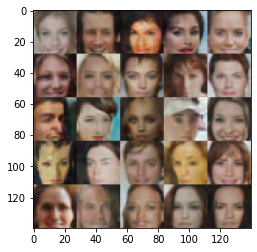

Epoch 5/10... Discriminator Loss: 1.5827... Generator Loss: 0.4626
Epoch 5/10... Discriminator Loss: 1.1499... Generator Loss: 0.9794


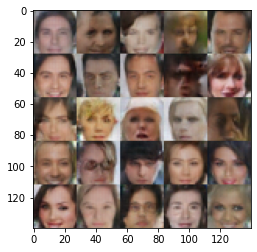

Epoch 5/10... Discriminator Loss: 1.5334... Generator Loss: 0.4243
Epoch 5/10... Discriminator Loss: 1.3620... Generator Loss: 0.5608


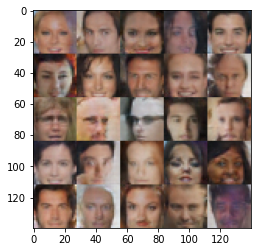

Epoch 5/10... Discriminator Loss: 1.7327... Generator Loss: 0.3397
Epoch 5/10... Discriminator Loss: 1.3075... Generator Loss: 0.6350


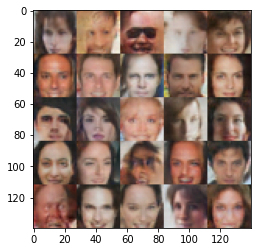

Epoch 5/10... Discriminator Loss: 1.5284... Generator Loss: 0.4226
Epoch 5/10... Discriminator Loss: 1.3193... Generator Loss: 0.6239


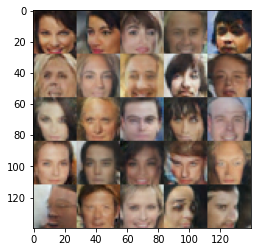

Epoch 5/10... Discriminator Loss: 1.4421... Generator Loss: 0.6683
Epoch 5/10... Discriminator Loss: 0.8515... Generator Loss: 1.2582


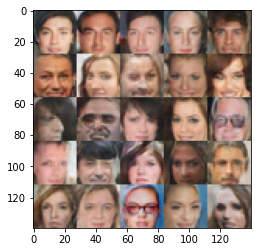

Epoch 5/10... Discriminator Loss: 1.4289... Generator Loss: 0.5956
Epoch 5/10... Discriminator Loss: 1.2612... Generator Loss: 0.7003


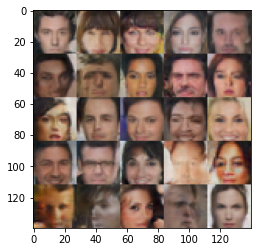

Epoch 5/10... Discriminator Loss: 0.9816... Generator Loss: 1.5102
Epoch 5/10... Discriminator Loss: 1.1744... Generator Loss: 0.6976


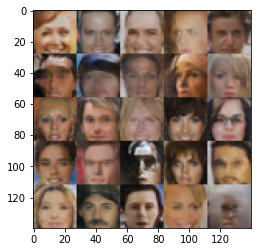

Epoch 5/10... Discriminator Loss: 0.9933... Generator Loss: 1.0907
Epoch 5/10... Discriminator Loss: 0.8926... Generator Loss: 1.0692


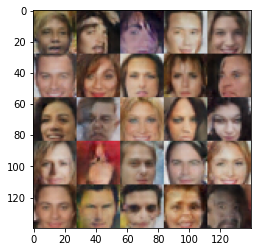

Epoch 5/10... Discriminator Loss: 1.0277... Generator Loss: 0.9165
Epoch 5/10... Discriminator Loss: 1.4318... Generator Loss: 0.5534


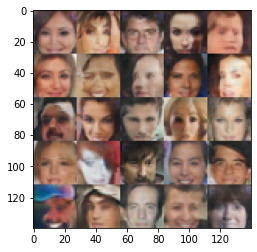

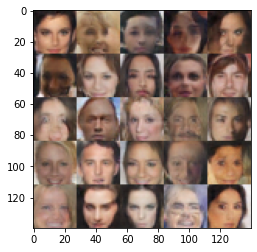

Epoch 6/10... Discriminator Loss: 1.1187... Generator Loss: 0.8473
Epoch 6/10... Discriminator Loss: 1.2259... Generator Loss: 0.7081


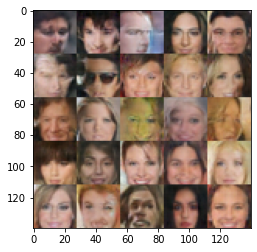

Epoch 6/10... Discriminator Loss: 0.9714... Generator Loss: 1.1616
Epoch 6/10... Discriminator Loss: 0.8239... Generator Loss: 1.1542


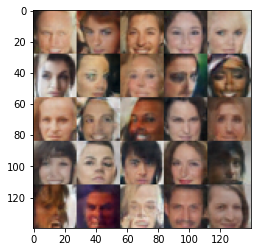

Epoch 6/10... Discriminator Loss: 1.4841... Generator Loss: 0.5002
Epoch 6/10... Discriminator Loss: 1.1054... Generator Loss: 1.1751


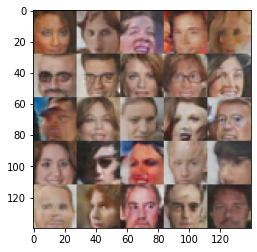

Epoch 6/10... Discriminator Loss: 2.0212... Generator Loss: 0.2541
Epoch 6/10... Discriminator Loss: 1.5475... Generator Loss: 0.5949


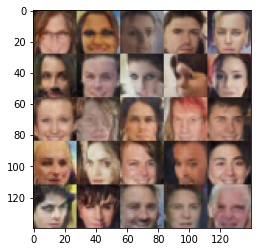

Epoch 6/10... Discriminator Loss: 1.2212... Generator Loss: 0.6450
Epoch 6/10... Discriminator Loss: 1.4331... Generator Loss: 0.4995


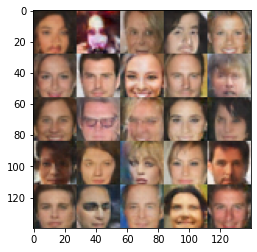

Epoch 6/10... Discriminator Loss: 1.6062... Generator Loss: 0.4267
Epoch 6/10... Discriminator Loss: 1.5864... Generator Loss: 0.4277


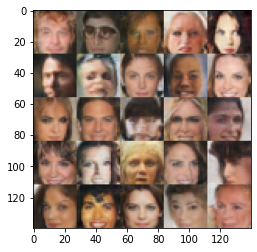

Epoch 6/10... Discriminator Loss: 1.6940... Generator Loss: 0.3527
Epoch 6/10... Discriminator Loss: 1.6560... Generator Loss: 0.4026


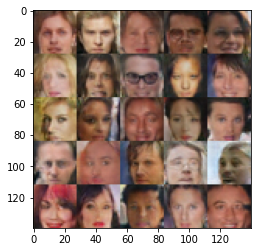

Epoch 6/10... Discriminator Loss: 0.9864... Generator Loss: 1.1137
Epoch 6/10... Discriminator Loss: 0.7288... Generator Loss: 1.3309


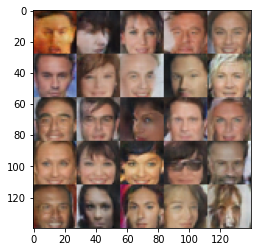

Epoch 6/10... Discriminator Loss: 0.7223... Generator Loss: 1.5483
Epoch 6/10... Discriminator Loss: 1.1549... Generator Loss: 0.8330


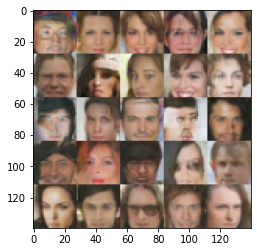

Epoch 6/10... Discriminator Loss: 1.4513... Generator Loss: 0.5408
Epoch 6/10... Discriminator Loss: 0.7795... Generator Loss: 1.4318


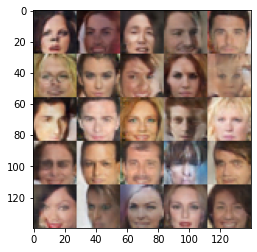

Epoch 6/10... Discriminator Loss: 1.9714... Generator Loss: 0.2857
Epoch 6/10... Discriminator Loss: 1.6922... Generator Loss: 0.3813


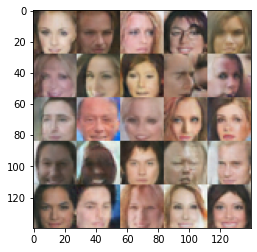

Epoch 6/10... Discriminator Loss: 0.9850... Generator Loss: 1.0429
Epoch 6/10... Discriminator Loss: 1.4275... Generator Loss: 0.6495


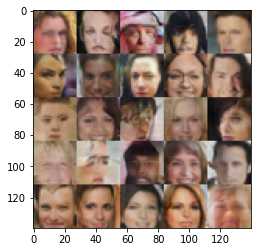

Epoch 6/10... Discriminator Loss: 1.5421... Generator Loss: 0.4370
Epoch 6/10... Discriminator Loss: 1.2286... Generator Loss: 0.6422


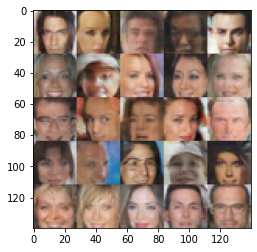

Epoch 6/10... Discriminator Loss: 1.1408... Generator Loss: 0.7751
Epoch 6/10... Discriminator Loss: 1.0989... Generator Loss: 1.0791


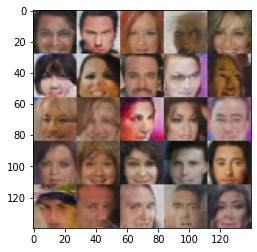

Epoch 6/10... Discriminator Loss: 1.5435... Generator Loss: 0.4823
Epoch 6/10... Discriminator Loss: 1.3993... Generator Loss: 0.5735


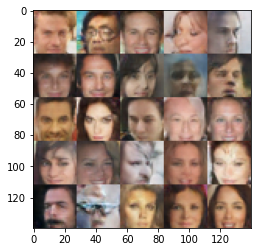

Epoch 6/10... Discriminator Loss: 0.7512... Generator Loss: 1.5190


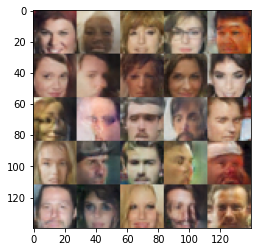

Epoch 7/10... Discriminator Loss: 1.1546... Generator Loss: 0.7650


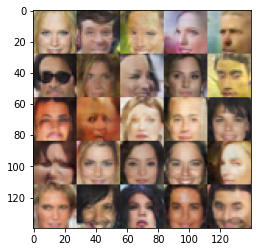

Epoch 7/10... Discriminator Loss: 1.2417... Generator Loss: 0.7064
Epoch 7/10... Discriminator Loss: 1.5937... Generator Loss: 0.4121


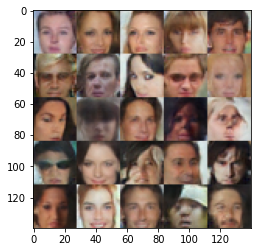

Epoch 7/10... Discriminator Loss: 1.4627... Generator Loss: 0.5639
Epoch 7/10... Discriminator Loss: 1.4293... Generator Loss: 0.5442


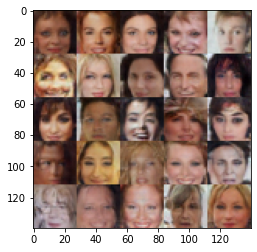

Epoch 7/10... Discriminator Loss: 1.2982... Generator Loss: 0.7001
Epoch 7/10... Discriminator Loss: 0.9307... Generator Loss: 1.1533


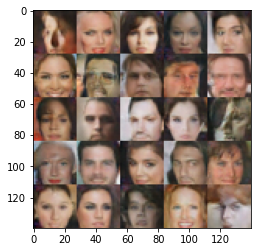

Epoch 7/10... Discriminator Loss: 1.7060... Generator Loss: 0.3864
Epoch 7/10... Discriminator Loss: 0.7520... Generator Loss: 1.4736


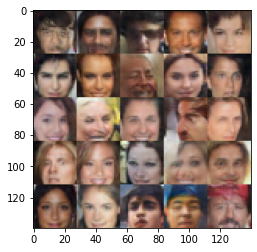

Epoch 7/10... Discriminator Loss: 1.1294... Generator Loss: 0.8710
Epoch 7/10... Discriminator Loss: 1.3436... Generator Loss: 0.6201


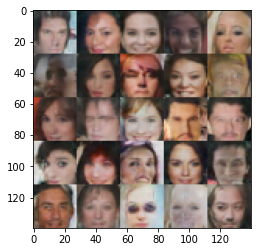

Epoch 7/10... Discriminator Loss: 1.4331... Generator Loss: 0.5814
Epoch 7/10... Discriminator Loss: 1.9375... Generator Loss: 0.2992


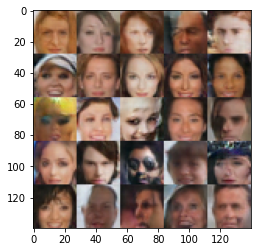

Epoch 7/10... Discriminator Loss: 1.1099... Generator Loss: 0.8454
Epoch 7/10... Discriminator Loss: 1.7812... Generator Loss: 0.3562


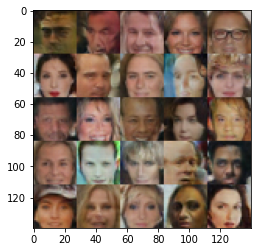

Epoch 7/10... Discriminator Loss: 0.7995... Generator Loss: 1.2913
Epoch 7/10... Discriminator Loss: 1.2871... Generator Loss: 0.6888


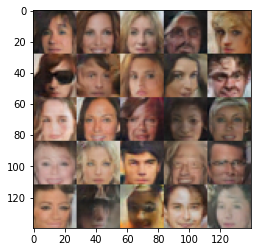

Epoch 7/10... Discriminator Loss: 1.1245... Generator Loss: 0.8195
Epoch 7/10... Discriminator Loss: 1.3408... Generator Loss: 0.7413


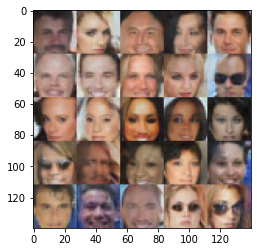

Epoch 7/10... Discriminator Loss: 1.2856... Generator Loss: 0.6456
Epoch 7/10... Discriminator Loss: 1.1728... Generator Loss: 0.7699


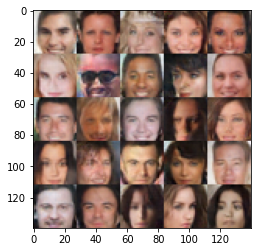

Epoch 7/10... Discriminator Loss: 1.2018... Generator Loss: 0.7660
Epoch 7/10... Discriminator Loss: 1.5035... Generator Loss: 0.4740


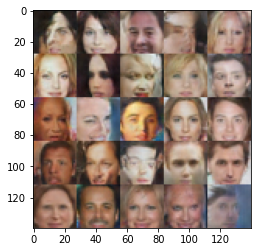

Epoch 7/10... Discriminator Loss: 0.9353... Generator Loss: 1.0612
Epoch 7/10... Discriminator Loss: 1.5401... Generator Loss: 0.4265


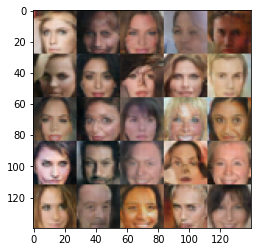

Epoch 7/10... Discriminator Loss: 1.2733... Generator Loss: 0.6880
Epoch 7/10... Discriminator Loss: 1.5974... Generator Loss: 0.4252


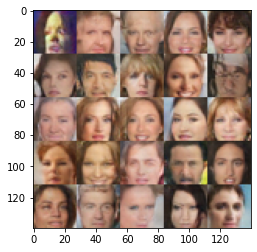

Epoch 7/10... Discriminator Loss: 1.1072... Generator Loss: 0.7583
Epoch 7/10... Discriminator Loss: 1.0572... Generator Loss: 0.8987


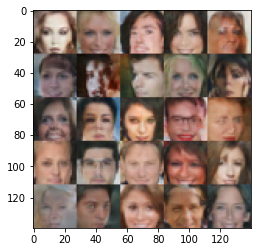

Epoch 7/10... Discriminator Loss: 1.4714... Generator Loss: 0.4631
Epoch 7/10... Discriminator Loss: 1.8173... Generator Loss: 0.3483


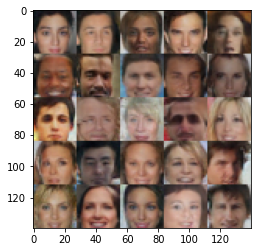

Epoch 7/10... Discriminator Loss: 1.3775... Generator Loss: 0.7425


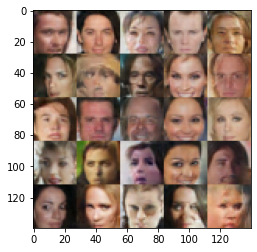

Epoch 8/10... Discriminator Loss: 0.9364... Generator Loss: 1.0126


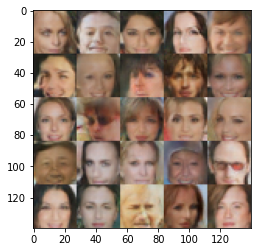

Epoch 8/10... Discriminator Loss: 1.4794... Generator Loss: 0.4776
Epoch 8/10... Discriminator Loss: 1.1855... Generator Loss: 0.7731


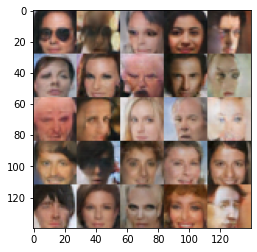

Epoch 8/10... Discriminator Loss: 0.8750... Generator Loss: 1.1001
Epoch 8/10... Discriminator Loss: 1.4274... Generator Loss: 0.5220


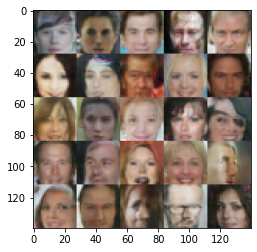

Epoch 8/10... Discriminator Loss: 1.2294... Generator Loss: 0.6799
Epoch 8/10... Discriminator Loss: 1.1536... Generator Loss: 0.7475


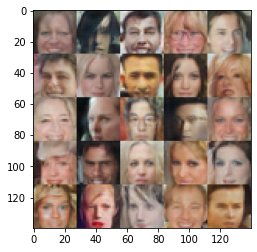

Epoch 8/10... Discriminator Loss: 1.2715... Generator Loss: 0.5977
Epoch 8/10... Discriminator Loss: 1.1565... Generator Loss: 0.7293


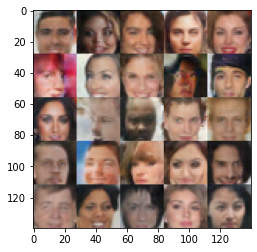

Epoch 8/10... Discriminator Loss: 1.0796... Generator Loss: 0.9435
Epoch 8/10... Discriminator Loss: 1.1863... Generator Loss: 0.7347


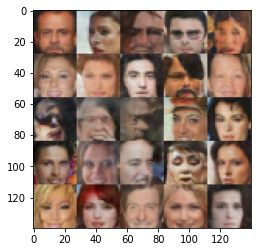

Epoch 8/10... Discriminator Loss: 1.2620... Generator Loss: 0.7384
Epoch 8/10... Discriminator Loss: 1.6032... Generator Loss: 0.5120


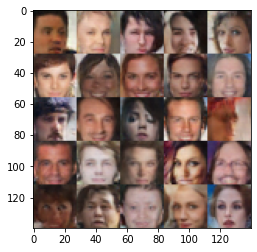

Epoch 8/10... Discriminator Loss: 1.3167... Generator Loss: 0.6528
Epoch 8/10... Discriminator Loss: 0.7785... Generator Loss: 1.4886


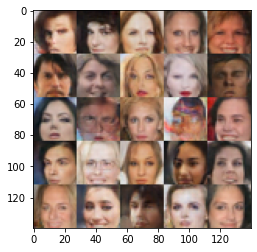

Epoch 8/10... Discriminator Loss: 1.2122... Generator Loss: 0.6561
Epoch 8/10... Discriminator Loss: 1.3025... Generator Loss: 0.6522


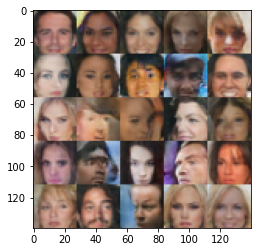

Epoch 8/10... Discriminator Loss: 1.0302... Generator Loss: 1.0537
Epoch 8/10... Discriminator Loss: 1.4209... Generator Loss: 0.5223


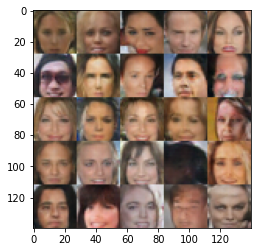

Epoch 8/10... Discriminator Loss: 1.4787... Generator Loss: 0.5199
Epoch 8/10... Discriminator Loss: 1.1298... Generator Loss: 0.9186


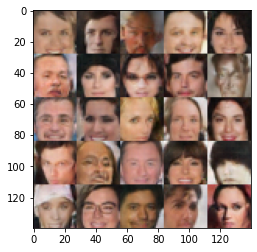

Epoch 8/10... Discriminator Loss: 1.2716... Generator Loss: 0.6332
Epoch 8/10... Discriminator Loss: 1.4562... Generator Loss: 0.5234


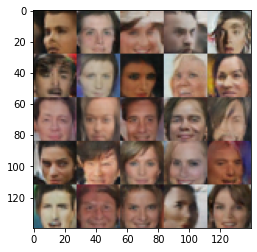

Epoch 8/10... Discriminator Loss: 1.0798... Generator Loss: 0.9728
Epoch 8/10... Discriminator Loss: 1.1066... Generator Loss: 0.8378


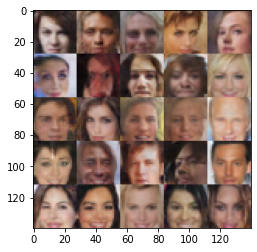

Epoch 8/10... Discriminator Loss: 1.1706... Generator Loss: 0.9681
Epoch 8/10... Discriminator Loss: 0.9947... Generator Loss: 1.0842


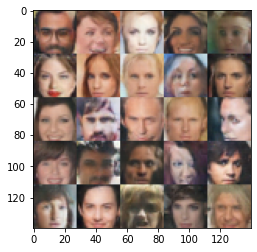

Epoch 8/10... Discriminator Loss: 1.2436... Generator Loss: 0.7003
Epoch 8/10... Discriminator Loss: 1.2160... Generator Loss: 0.6519


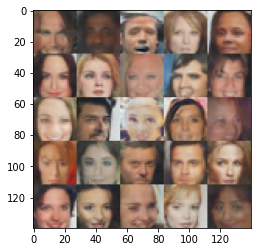

Epoch 8/10... Discriminator Loss: 1.2390... Generator Loss: 0.7528
Epoch 8/10... Discriminator Loss: 1.0645... Generator Loss: 0.9207


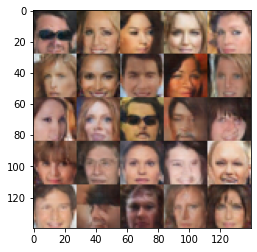

Epoch 8/10... Discriminator Loss: 1.2055... Generator Loss: 0.7542


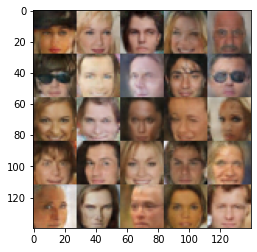

Epoch 9/10... Discriminator Loss: 1.0659... Generator Loss: 0.8653


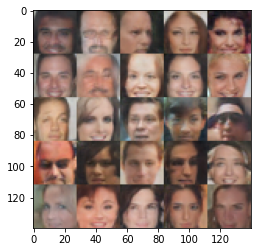

Epoch 9/10... Discriminator Loss: 1.1388... Generator Loss: 1.2156
Epoch 9/10... Discriminator Loss: 1.4834... Generator Loss: 0.4423


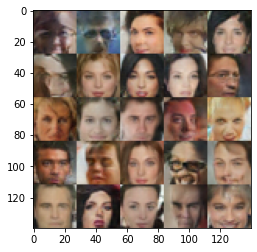

Epoch 9/10... Discriminator Loss: 1.2946... Generator Loss: 0.5854
Epoch 9/10... Discriminator Loss: 1.4472... Generator Loss: 0.5947


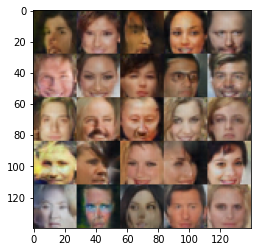

Epoch 9/10... Discriminator Loss: 1.4267... Generator Loss: 0.6221
Epoch 9/10... Discriminator Loss: 1.2241... Generator Loss: 0.7252


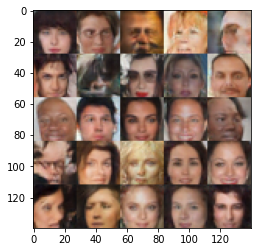

Epoch 9/10... Discriminator Loss: 1.3529... Generator Loss: 0.5561
Epoch 9/10... Discriminator Loss: 1.1077... Generator Loss: 0.8922


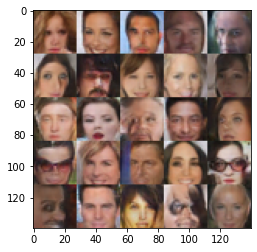

Epoch 9/10... Discriminator Loss: 1.2429... Generator Loss: 0.6635
Epoch 9/10... Discriminator Loss: 1.0721... Generator Loss: 0.9967


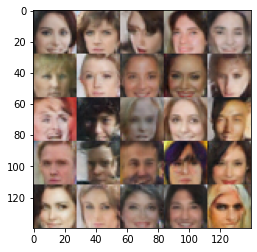

Epoch 9/10... Discriminator Loss: 0.9867... Generator Loss: 0.8942
Epoch 9/10... Discriminator Loss: 1.2317... Generator Loss: 0.7070


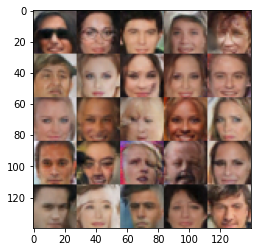

Epoch 9/10... Discriminator Loss: 1.3045... Generator Loss: 0.5877
Epoch 9/10... Discriminator Loss: 1.4874... Generator Loss: 0.5526


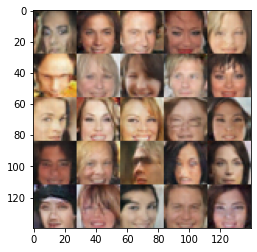

Epoch 9/10... Discriminator Loss: 1.2299... Generator Loss: 0.7247
Epoch 9/10... Discriminator Loss: 1.0039... Generator Loss: 0.9633


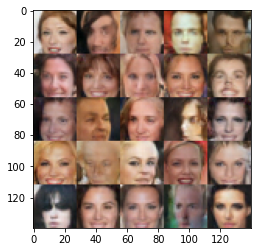

Epoch 9/10... Discriminator Loss: 1.0466... Generator Loss: 0.8619
Epoch 9/10... Discriminator Loss: 1.2142... Generator Loss: 0.6833


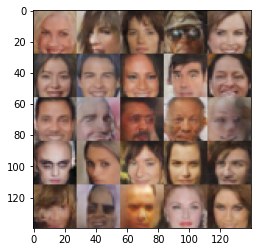

Epoch 9/10... Discriminator Loss: 1.6642... Generator Loss: 0.3889
Epoch 9/10... Discriminator Loss: 1.3962... Generator Loss: 0.5761


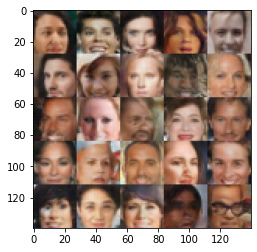

Epoch 9/10... Discriminator Loss: 1.3955... Generator Loss: 0.5274
Epoch 9/10... Discriminator Loss: 1.1888... Generator Loss: 0.7588


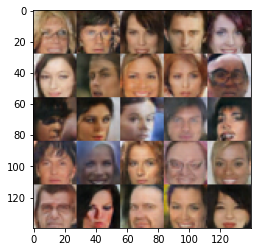

Epoch 9/10... Discriminator Loss: 1.6927... Generator Loss: 0.4306
Epoch 9/10... Discriminator Loss: 1.2815... Generator Loss: 0.7174


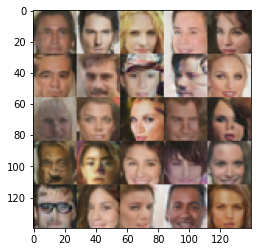

Epoch 9/10... Discriminator Loss: 0.8950... Generator Loss: 1.1460
Epoch 9/10... Discriminator Loss: 1.0621... Generator Loss: 0.8033


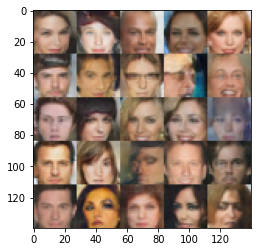

Epoch 9/10... Discriminator Loss: 1.4003... Generator Loss: 0.5354
Epoch 9/10... Discriminator Loss: 1.4709... Generator Loss: 0.5989


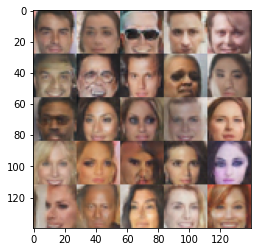

Epoch 9/10... Discriminator Loss: 1.4706... Generator Loss: 0.6015
Epoch 9/10... Discriminator Loss: 1.8070... Generator Loss: 0.2998


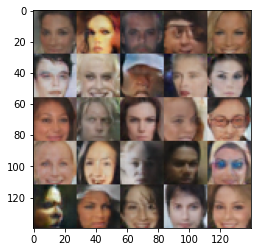

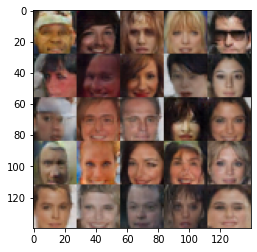

Epoch 10/10... Discriminator Loss: 0.7725... Generator Loss: 1.3947
Epoch 10/10... Discriminator Loss: 0.8149... Generator Loss: 1.6764


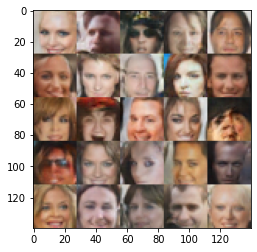

Epoch 10/10... Discriminator Loss: 1.3319... Generator Loss: 0.5704
Epoch 10/10... Discriminator Loss: 1.0805... Generator Loss: 1.0646


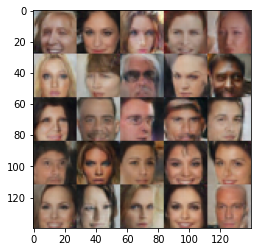

Epoch 10/10... Discriminator Loss: 1.3600... Generator Loss: 0.6046
Epoch 10/10... Discriminator Loss: 1.8727... Generator Loss: 0.3592


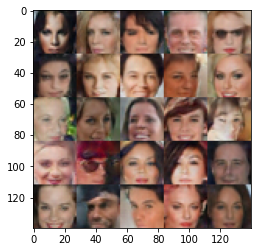

Epoch 10/10... Discriminator Loss: 1.1637... Generator Loss: 0.9171
Epoch 10/10... Discriminator Loss: 0.6550... Generator Loss: 1.7160


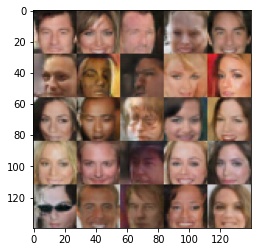

Epoch 10/10... Discriminator Loss: 1.0933... Generator Loss: 0.8187
Epoch 10/10... Discriminator Loss: 2.2487... Generator Loss: 0.2020


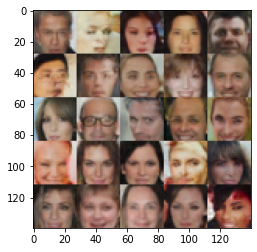

Epoch 10/10... Discriminator Loss: 1.1065... Generator Loss: 0.8083
Epoch 10/10... Discriminator Loss: 1.1744... Generator Loss: 0.7460


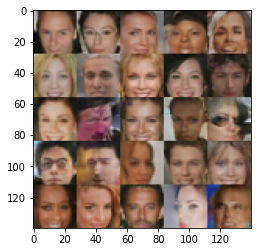

Epoch 10/10... Discriminator Loss: 1.2758... Generator Loss: 0.7217
Epoch 10/10... Discriminator Loss: 1.1510... Generator Loss: 0.8690


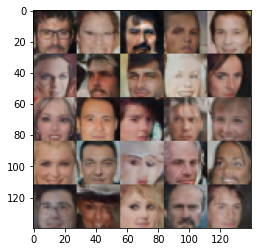

Epoch 10/10... Discriminator Loss: 0.9641... Generator Loss: 0.9458
Epoch 10/10... Discriminator Loss: 1.4256... Generator Loss: 0.5968


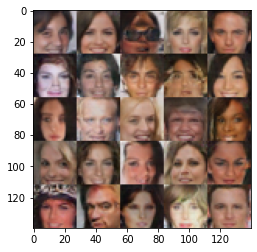

Epoch 10/10... Discriminator Loss: 0.9558... Generator Loss: 1.0169
Epoch 10/10... Discriminator Loss: 1.1838... Generator Loss: 0.7015


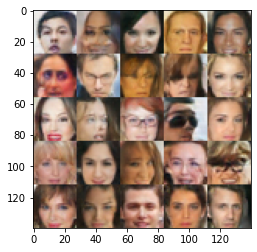

Epoch 10/10... Discriminator Loss: 1.3845... Generator Loss: 0.6318
Epoch 10/10... Discriminator Loss: 1.4147... Generator Loss: 0.5205


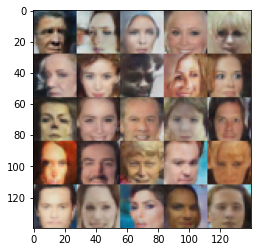

Epoch 10/10... Discriminator Loss: 0.8819... Generator Loss: 1.1207
Epoch 10/10... Discriminator Loss: 1.1676... Generator Loss: 0.7896


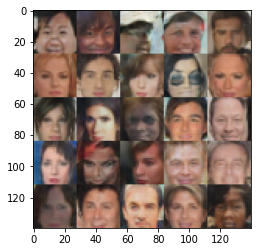

Epoch 10/10... Discriminator Loss: 1.0888... Generator Loss: 0.7946
Epoch 10/10... Discriminator Loss: 1.0826... Generator Loss: 0.9418


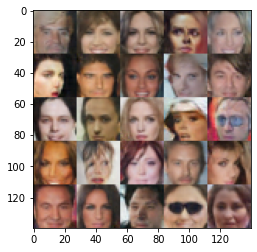

Epoch 10/10... Discriminator Loss: 1.7425... Generator Loss: 0.3852
Epoch 10/10... Discriminator Loss: 1.6728... Generator Loss: 0.4110


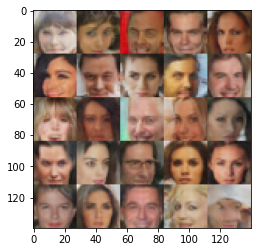

Epoch 10/10... Discriminator Loss: 1.1781... Generator Loss: 0.7539
Epoch 10/10... Discriminator Loss: 1.4244... Generator Loss: 0.5354


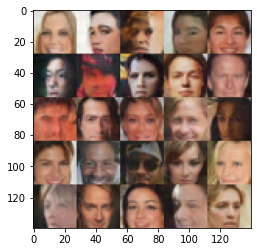

Epoch 10/10... Discriminator Loss: 1.1644... Generator Loss: 0.7540
Epoch 10/10... Discriminator Loss: 0.9638... Generator Loss: 1.0048


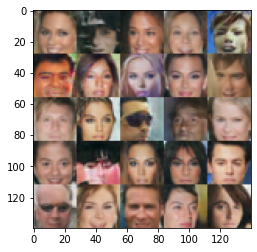

Epoch 10/10... Discriminator Loss: 0.7987... Generator Loss: 1.3109
Epoch 10/10... Discriminator Loss: 0.9256... Generator Loss: 1.1934


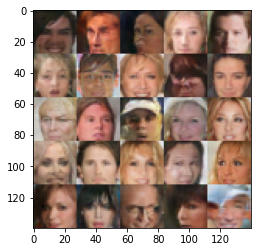

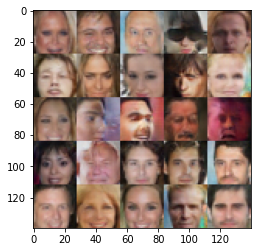

In [17]:
batch_size = 32
z_dim = 128
learning_rate = 0.0002
beta1 = 0.5

epochs = 10

celeba_dataset = Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

# Final notes
This notebook shows how training a DCGAN network can generate totally artificial human faces from random inputs! The DCGANs have the potential to generate not only images, but music, style-transfer, super-resolution, or even data from borrowers-that-might-experience-financial-distress-in-the-near-future, just to mention a few examples.